In [ ]:
!pip install node2vec

  Created wheel for node2vec: filename=node2vec-0.4.0-cp36-none-any.whl size=5727 sha256=f5badbedf3d62fb25de92146ad915177994be1a0750195eb512f80efcaed98cb
  Stored in directory: /root/.cache/pip/wheels/68/64/b9/599a860e730d0a4c633db99e5dcd8c4beee4ff9e3d5b3a011a
Successfully built node2vec


In [ ]:
# импортируем нужные библиотеки
import matplotlib.pyplot as plt
%matplotlib inline

import collections
from collections import Counter

from networkx.algorithms import community
from networkx.algorithms.community import greedy_modularity_communities
from networkx.algorithms.community import label_propagation_communities

from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.metrics.pairwise import cosine_distances
import scipy.spatial as spt
import scipy.cluster.hierarchy as shc

import urllib
import networkx as nx
import numpy as np
import pandas as pd
from tqdm.notebook import tqdm
import csv
import json
from node2vec import Node2Vec

# Загрузка данных с предыдущего шага

Загружаем словарь с очищенными данными из предыдущего файла. А также список связей для графа комиксов Marvel. 

In [ ]:
#загружаем словарь со всеми персонажами из json
with open('marvel_movie_universe_heroes_clean.json', 'r', encoding='utf-8') as fh: 
    heroes = json.load(fh)

In [ ]:
# создаем список со списками героев из каждого фильма
ner_sents = []
for film, cast in heroes.items():
  ner_sents.append(cast)

In [ ]:
# создаем список пар героев, чтобы потом посчитать их совместную встречаемость
pairs = []

for sent in ner_sents:
  if len(sent) > 1:
    for i in range(len(sent)-1):
      for j in range(i, len(sent)):
        if i != j:
          pair = (min(sent[i], sent[j]), max(sent[i], sent[j]))
          pairs.append(pair)

In [ ]:
# испортируем данные по комиксам
marvel_comics = []

with open('marvel-unimodal-edges.csv') as csvfile:
  reader = csv.DictReader(csvfile)
  for row in reader:
    marvel_comics.append((row['Source'], row['Target'], {'weight': int(row['Weight'])}))

# Сравниваем структуру графов

Задача: проверить, насколько похожи структуры графов, построенных по фильмам и комиксам Marvel. Для этого я посчитаю количество узлов и ребер для каждого графа, посчитаю количество троек, циклов и клик, проверю, выполняется ли степенной закон. 

In [ ]:
#Loading the network frame
G_films = nx.Graph((x, y, {'weight': v}) for (x, y), v in Counter(pairs).items())
G_comics = nx.Graph(tuple(marvel_comics))

print('Marvel films')
print("Number of nodes in a graph: ", len(G_films.nodes()))
print("Number of edges in a graph: ", len(G_films.edges()))
print('---------------------------')
print('Marvel comics')
print("Number of nodes in a graph: ", len(G_comics.nodes()))
print("Number of edges in a graph: ", len(G_comics.edges()))

Marvel films
Number of nodes in a graph:  372
Number of edges in a graph:  7959
---------------------------
Marvel comics
Number of nodes in a graph:  327
Number of edges in a graph:  9891


Количество узлов похоже, но в графе комиксов гораздо больше ребер. Возможно, это связано с тем, что граф комиксов более полносвязный. Проверим это, посчитав количество связных троек, циклов и клик. 

In [ ]:
def get_cycls(G, links):
  cycls = [c for c in nx.cycle_basis(G) if len(c)==links]
  return len(cycls)

In [ ]:
print('----------  Films  Comics')
print('Triangles: ', get_cycls(G_films, 3), ' ', get_cycls(G_comics, 3))
print('Squares:   ', get_cycls(G_films, 4), '   ', get_cycls(G_comics, 4))
print('Pentagon:  ', get_cycls(G_films, 5), '   ', get_cycls(G_comics, 5))

----------  Films  Comics
Triangles:  7511   7761
Squares:    20     488
Pentagon:   22     331


Предположение подтвердилось: количество связных троек в графах примерно похоже, но количество четверок и пятерок в графе фильмов почти в 10 раз меньше, чем в графе комиксов. То есть граф комиксов более плотный и связный, чем граф фильмов. Это может говорить о том, что в комиксах больше отсылок к другим героям вселенной, чем в фильмах. Большинство фильмов посвящены одному или нескольким героям. Фильмов, показывающих связь между всеми героями вселенной, единицы. 


In [ ]:
def power_law(G, title):
  
  degrees = np.array(list(dict(G.degree()).values()))
  d = Counter(degrees)

  plt.xlabel('degrees')
  plt.ylabel('nodes')
  plt.title(title)
  plt.loglog(list(d.keys()), list(d.values()), '.', lw=2)

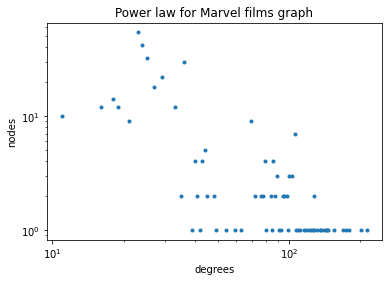

In [ ]:
power_law(G_films, 'Power law for Marvel films graph')
plt.savefig('power_law_films_full.png')

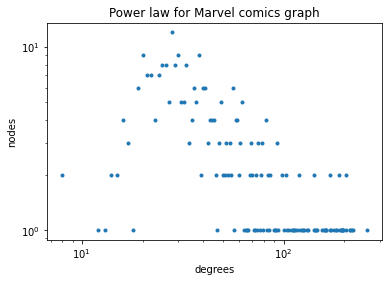

In [ ]:
power_law(G_comics, 'Power law for Marvel comics graph')
plt.savefig('power_law_comics_full.png')

Степенной закон для графа комиксов выполняется лучше, чем для графа фильмов. 

# Избавляемся от слабых связей

На предыдущем шаге я сравнивала стуктуры графов целиком. Но оба графа взвешенные, поэтому у нас есть возможность избавиться от слабых связей и привести оба графа к похожей структуре, то есть подобрать такое количество узлов, чтобы примерно совпадало и количество ребер. На этом шаге подберем веса для создания одинаковых подграфов, а также сравним их структуры, как и в предыдущем шаге (посчитаем количество узлов и ребер для каждого графа, посчитаем количество троек, циклов и клик, проверим степенной закон).

In [ ]:
def nodes_for_subgraph(G, weight):
  
  edges_select = [(u, v) for (u, v, d) in G.edges(data=True) if d['weight'] > weight]

  unique_heroes = []
  
  for i in edges_select:
    for j in i:
      if j not in unique_heroes:
        unique_heroes.append(j)
  
  return tuple(unique_heroes)

In [ ]:
special_nodes_films = nodes_for_subgraph(G_films, 2)
special_nodes_comics = nodes_for_subgraph(G_comics, 150)

In [ ]:
G_films_small = nx.subgraph(G_films, special_nodes_films)
G_comics_small = nx.subgraph(G_comics, special_nodes_comics)

print('Marvel films')
print("Number of nodes in a graph: ", len(G_films_small.nodes()))
print("Number of edges in a graph: ", len(G_films_small.edges()))
print('---------------------------')
print('Marvel comics')
print("Number of nodes in a graph: ", len(G_comics_small.nodes()))
print("Number of edges in a graph: ", len(G_comics_small.edges()))

Marvel films
Number of nodes in a graph:  55
Number of edges in a graph:  1228
---------------------------
Marvel comics
Number of nodes in a graph:  66
Number of edges in a graph:  1269


При весе больше двух для графа фильмов (то есть оставляем только тех героев, которые встречались вместе больше, чем в двух фильмах) и больше 150 для графа комиксов получаем графы с примерно похожим количество узлов и ребер.

In [ ]:
print('----------  Films  Comics')
print('Triangles: ', get_cycls(G_films_small, 3), ' ', get_cycls(G_comics_small, 3))
print('Squares:   ', get_cycls(G_films_small, 4), '    ', get_cycls(G_comics_small, 4))
print('Pentagon:  ', get_cycls(G_films_small, 5), '    ', get_cycls(G_comics_small, 5))

----------  Films  Comics
Triangles:  1170   1180
Squares:    4      16
Pentagon:   0      7


Для подграфов работает тот же вывод, что и для графов целиком, о котором я писала выше. То есть граф комиксов более плотный и связный, чем граф фильмов. 

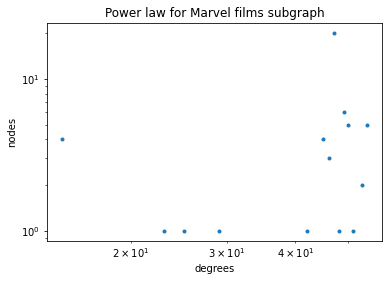

In [ ]:
power_law(G_films_small, 'Power law for Marvel films subgraph')
plt.savefig('power_law_films_sub.png')

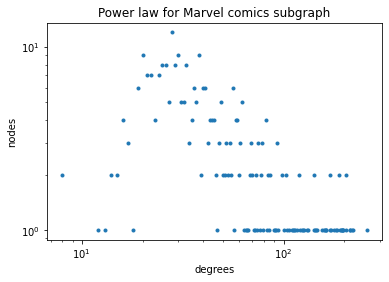

In [ ]:
power_law(G_comics, 'Power law for Marvel comics subgraph')
plt.savefig('power_law_comics_sub.png')

В отличие от графа целиком, степенной закон для подграфа фильмов не выполняется. 

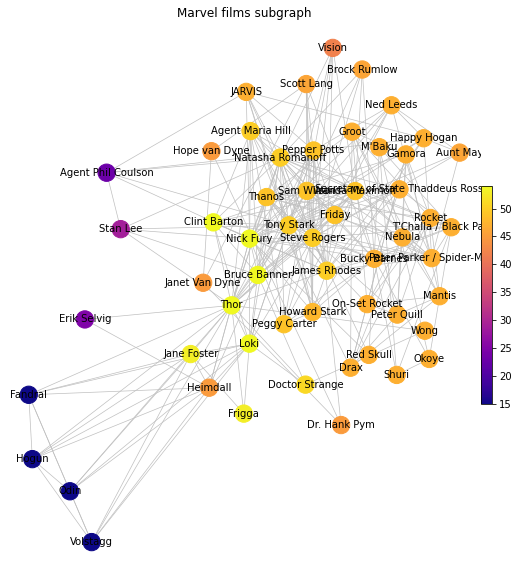

In [ ]:
plt.figure(figsize=(10,10))

edges_new_films = [(u, v) for (u, v, d) in G_films.edges(data=True) if d['weight'] > 2]
k = dict(G_films_small.degree)
node_colors = list(k.values())

pos = nx.spring_layout(G_films_small)
nodes = nx.draw_networkx_nodes(G_films_small, pos, node_color=node_colors, 
                               node_size=300, cmap='plasma')
nx.draw_networkx_edges(G_films_small, pos, edgelist=edges_new_films, 
                       edge_color='silver', width=.7)
nx.draw_networkx_labels(G_films_small, pos, font_size=10, font_family='sans-serif')

plt.colorbar(nodes, shrink=.4, pad=.0005, aspect=20)
plt.axis('off')
plt.title('Marvel films subgraph')
plt.savefig('marvel_subgraph_films_heroes.png')

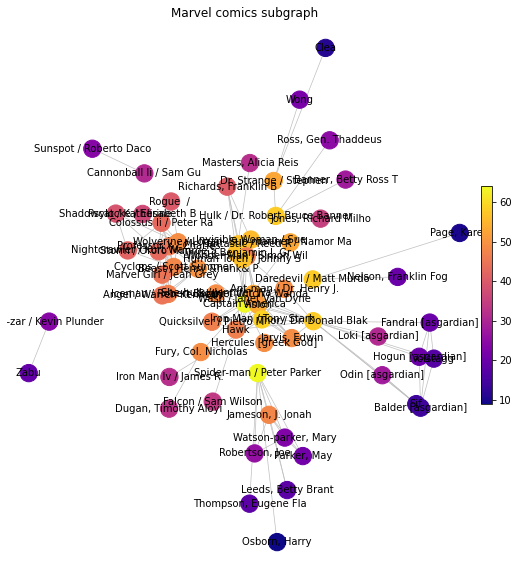

In [ ]:
plt.figure(figsize=(10,10))

edges_new_comics = [(u, v) for (u, v, d) in G_comics.edges(data=True) if d['weight'] > 150]
k = dict(G_comics_small.degree)
node_colors = list(k.values())

pos = nx.spring_layout(G_comics_small)
nodes = nx.draw_networkx_nodes(G_comics_small, pos, node_color=node_colors, 
                               node_size=300, cmap='plasma')
nx.draw_networkx_edges(G_comics_small, pos, edgelist=edges_new_comics, 
                       edge_color='silver', width=.7)
nx.draw_networkx_labels(G_comics_small, pos, font_size=10, font_family='sans-serif')

plt.colorbar(nodes, shrink=.4, pad=.0005, aspect=20)
plt.axis('off')
plt.title('Marvel comics subgraph')
plt.savefig('marvel_subgraph_comics_heroes.png')

In [ ]:
print('Marvel films')
print("Number of connected components in a graph: ", len(list(nx.connected_components(G_films_small))))
print('---------------------------')
print('Marvel comics')
print("Number of connected components in a graph: ", len(list(nx.connected_components(G_comics_small))))

Marvel films
Number of connected components in a graph:  1
---------------------------
Marvel comics
Number of connected components in a graph:  1


# Кластеризация

Так как подграф фильмов состоит по сути из двух кластеров (это видно на графике с визуализацей degree), кластеризацию мы будем строить по полным графам фильмов и комиксов, чтобы было что сравнить в конце. 

### Affinity matrices

In [ ]:
#Method to plot affinity matrices
def plotDist(A):
    
    f, ax = plt.subplots(2, 2, figsize=(10,10))
    ax[0, 0].imshow(A, cmap = 'Greys', interpolation = 'None')
    ax[0, 0].set_title('Adjacency Matrix')
    
    D = np.corrcoef(A)
    ax[1, 0].imshow(D, cmap = 'Greys', interpolation = 'None')
    ax[1, 0].set_title('Correlation coeff.')
    
    dVec = spt.distance.pdist(A, metric = 'euclidean')
    D = spt.distance.squareform(dVec)
    ax[0, 1].imshow(D, cmap = 'Greys', interpolation = 'None')
    ax[0, 1].set_title('Euclidean Dist.')
    
    dVec = spt.distance.pdist(A, metric = 'cosine')
    D = spt.distance.squareform(dVec)
    ax[1, 1].imshow(D, cmap = 'Greys', interpolation = 'None')
    ax[1, 1].set_title('Cosine Dist.')

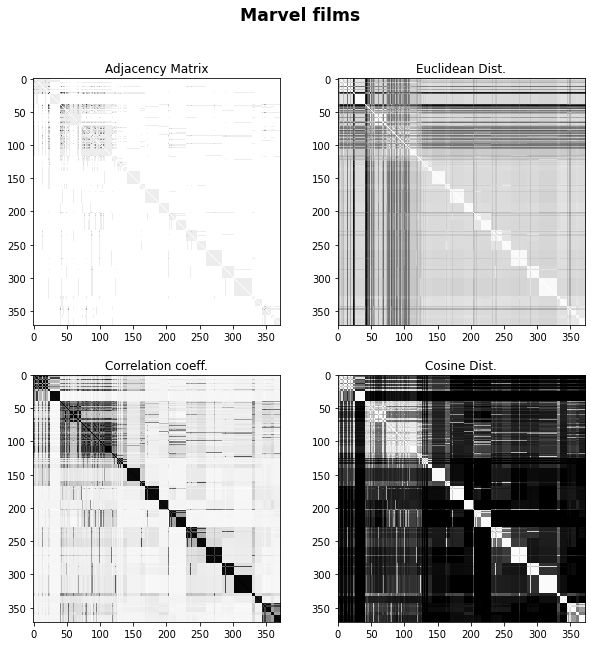

In [ ]:
#Plotting matrices
A = nx.to_numpy_matrix(G_films, dtype=int)
A = np.asarray(A)

plotDist(A)
plt.suptitle('Marvel films', fontsize='xx-large', fontweight='bold')
plt.savefig('marvel_films_matrix.png')

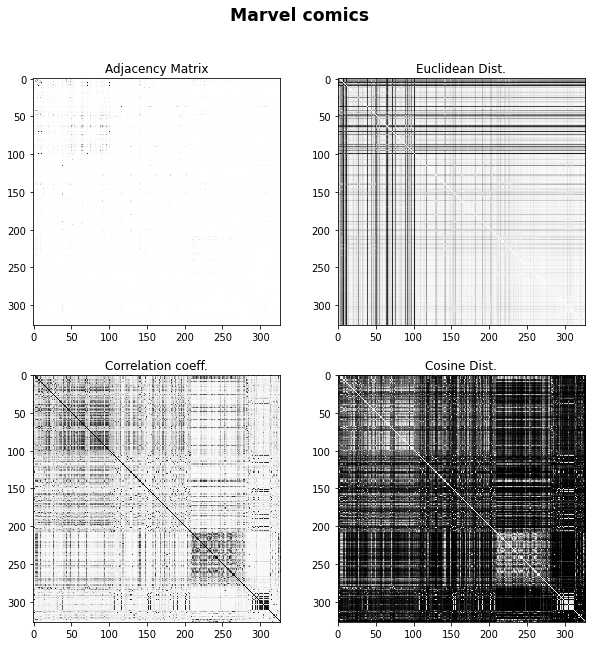

In [ ]:
#Plotting matrices
A = nx.to_numpy_matrix(G_comics, dtype=int)
A = np.asarray(A)

plotDist(A)
plt.suptitle('Marvel comics', fontsize='xx-large', fontweight='bold')
plt.savefig('marvel_comics_matrix.png')

### Agglomerative clusters

In [ ]:
#Compute cosine distances matrix
Agg_comics = cosine_distances(nx.to_numpy_matrix(G_comics, dtype=int))
Agg_films = cosine_distances(nx.to_numpy_matrix(G_films, dtype=int))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  This is separate from the ipykernel package so we can avoid doing imports until


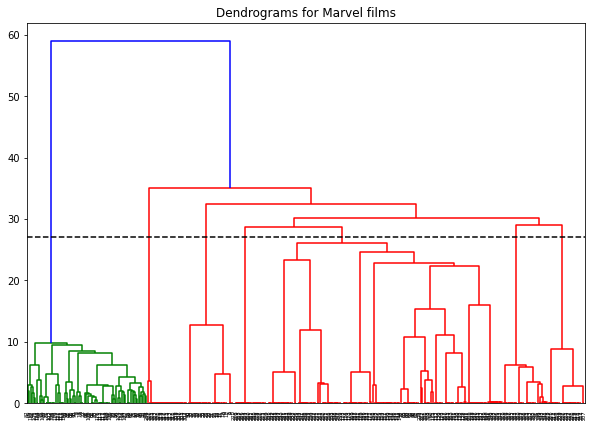

In [ ]:
plt.figure(figsize=(10, 7))  
plt.title("Dendrograms for Marvel films")  
dend = shc.dendrogram(shc.linkage(Agg_films, method='ward'))
plt.axhline(y=27, color='black', linestyle='--')
plt.savefig('dendrograms_films.png')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  This is separate from the ipykernel package so we can avoid doing imports until


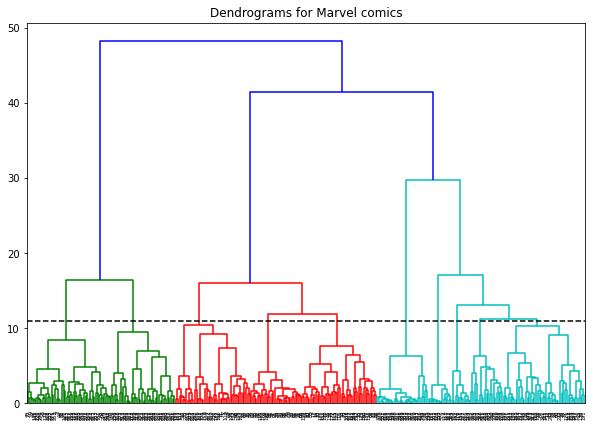

In [ ]:
plt.figure(figsize=(10, 7))  
plt.title("Dendrograms for Marvel comics")  
dend = shc.dendrogram(shc.linkage(Agg_comics, method='ward'))
plt.axhline(y=11, color='black', linestyle='--')
#plt.savefig('dendrograms_comics.png')

/usr/local/lib/python3.6/dist-packages/scipy/cluster/hierarchy.py:830: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='ward', metric='euclidean')


(-0.95, 1.05, -1.0, 0.75)

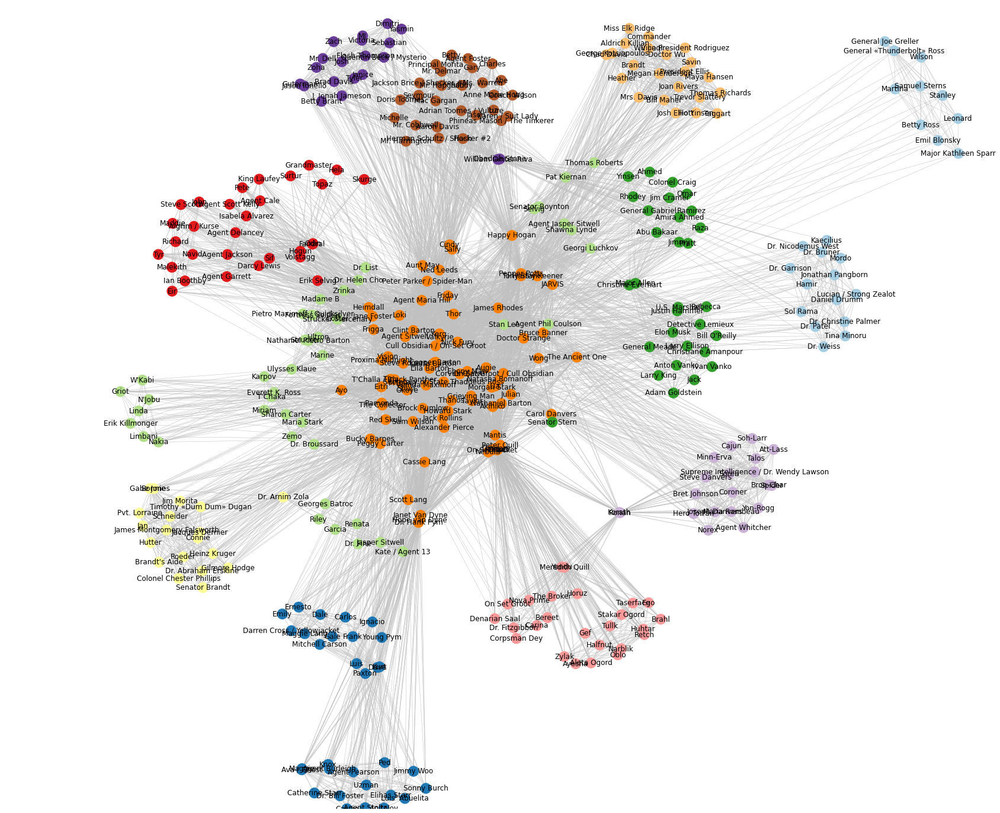

In [ ]:
#Compute agglomerative clusters

cluster = AgglomerativeClustering(n_clusters=12, affinity='euclidean', linkage='ward')
clusters = list(cluster.fit_predict(Agg_films))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_films, node_color=clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1.2, 1.])
plt.axis('off')

/usr/local/lib/python3.6/dist-packages/scipy/cluster/hierarchy.py:830: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='ward', metric='euclidean')


(-0.95, 1.05, -1.0, 0.75)

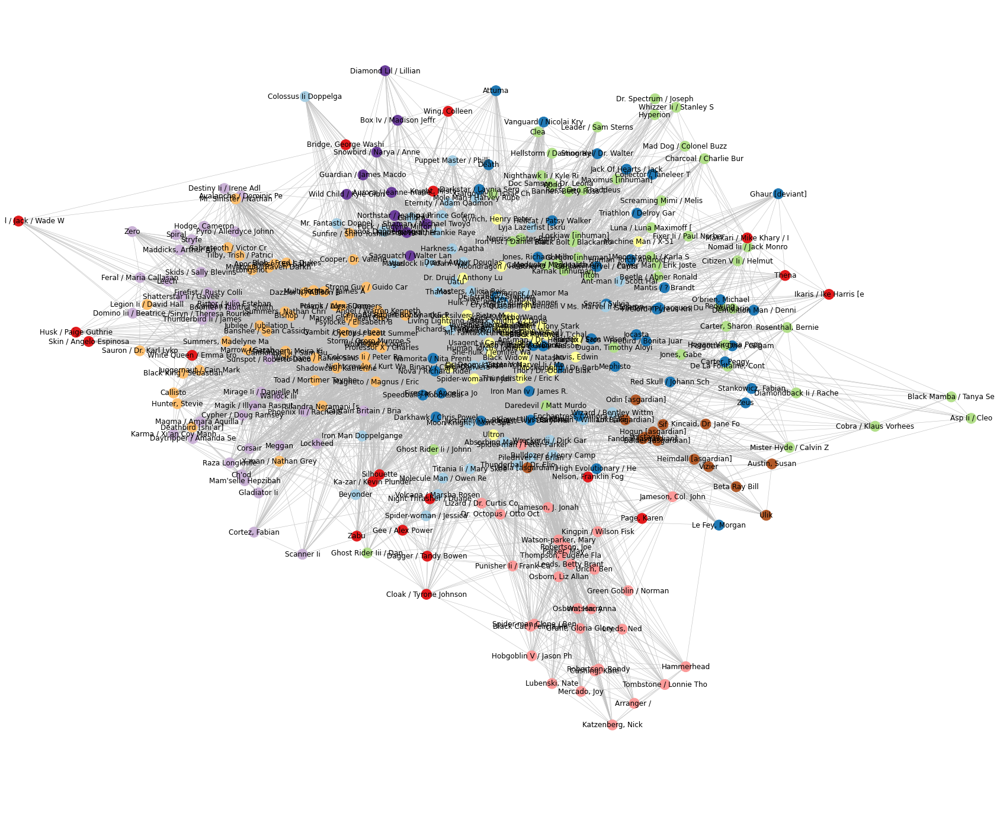

In [ ]:
#Compute agglomerative clusters

cluster = AgglomerativeClustering(n_clusters=10, affinity='euclidean', linkage='ward')
clusters = list(cluster.fit_predict(Agg_comics))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_comics, node_color=clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1., .75])
plt.axis('off')

### DBSCAN clusters

Number of clusters:  12
Number of noise noddes:  0


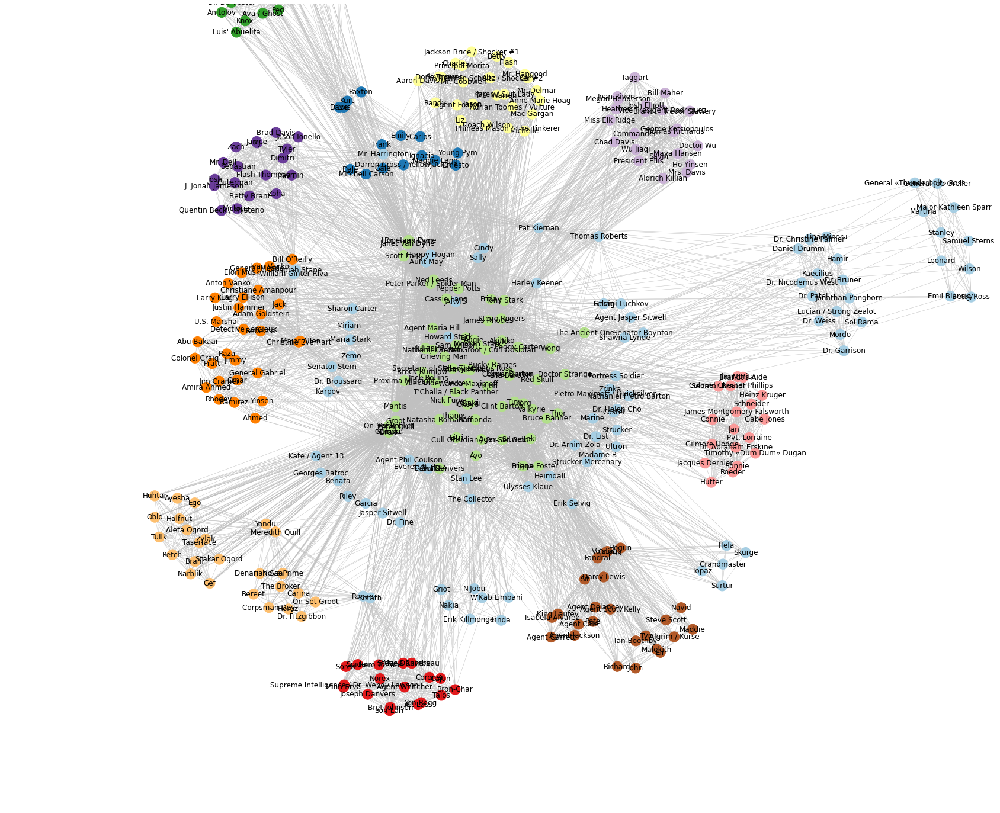

In [ ]:
#Compute DBSCAN clusters

db = DBSCAN(eps=2.0, min_samples=15)
db_clusters = list(db.fit_predict(Agg_films))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_films, node_color=db_clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1.2, 1.])
plt.axis('off')

print('Number of clusters: ', max(db_clusters)-min(db_clusters)+1)
print('Number of noise noddes: ', np.sum(db_clusters==-1))

Number of clusters:  5
Number of noise noddes:  0


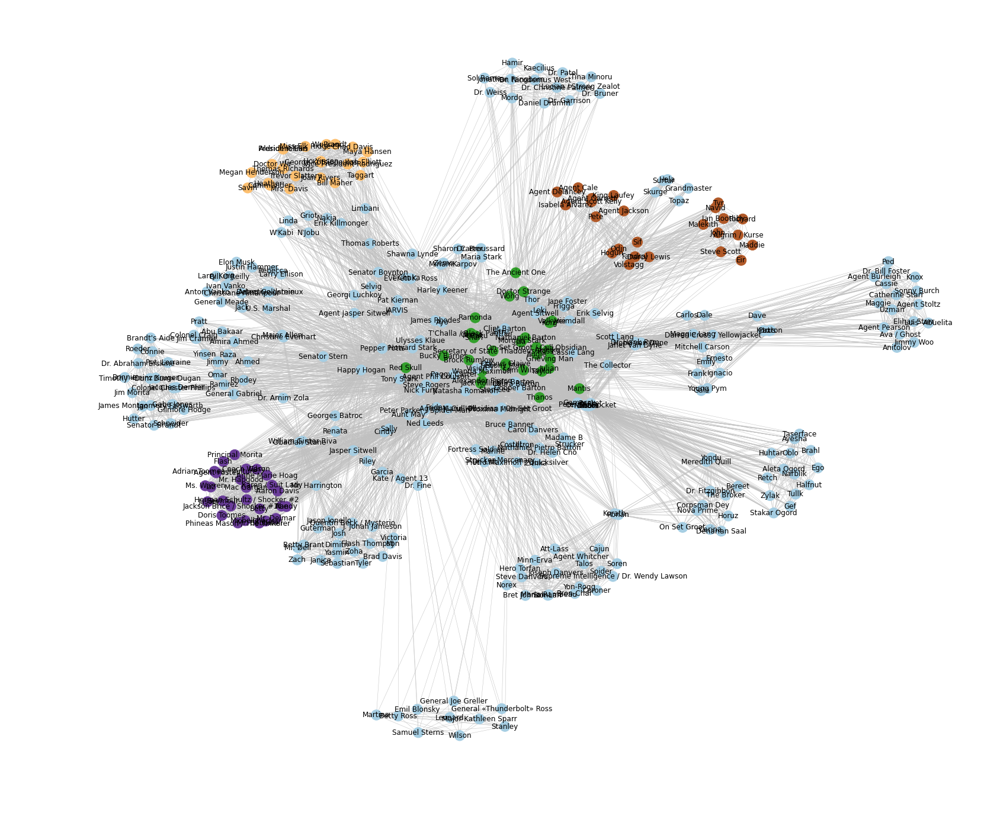

In [ ]:
#Compute DBSCAN clusters

db = DBSCAN(eps=1.5, min_samples=19)
db_clusters = list(db.fit_predict(Agg_films))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_films, node_color=db_clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1.2, 1.])
plt.axis('off')

print('Number of clusters: ', max(db_clusters)-min(db_clusters)+1)
print('Number of noise noddes: ', np.sum(db_clusters==-1))

Number of clusters:  10
Number of noise noddes:  0


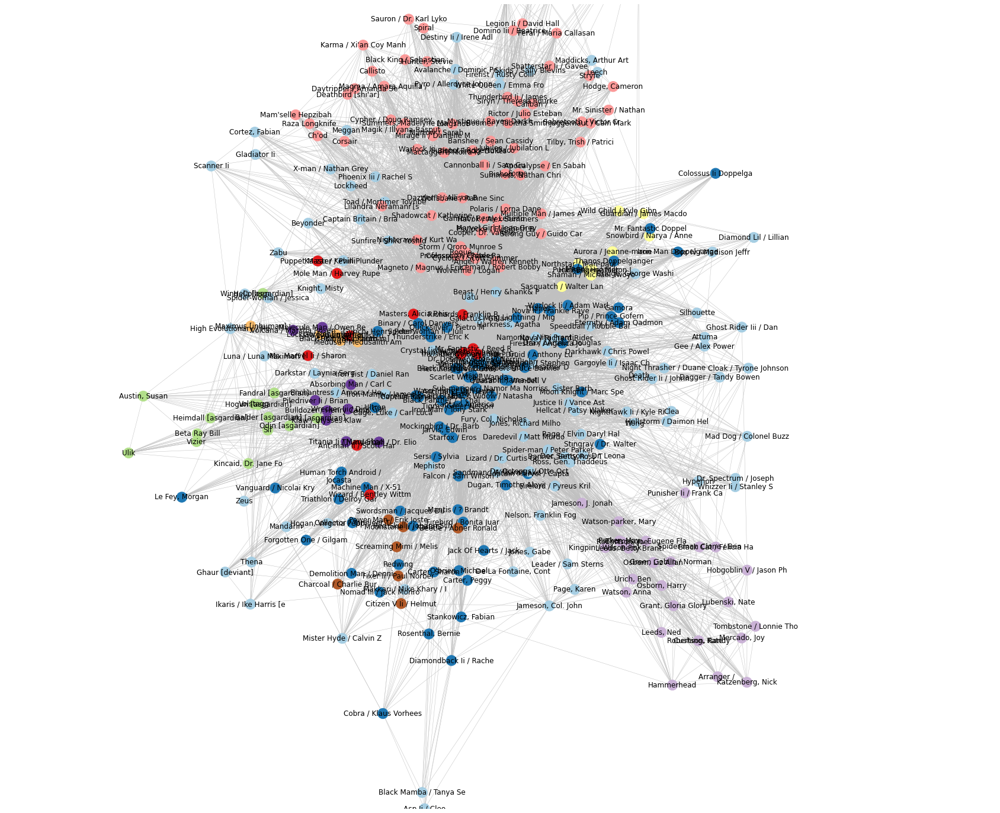

In [ ]:
#Compute DBSCAN clusters

db = DBSCAN(eps=1.5, min_samples=7)
db_clusters = list(db.fit_predict(Agg_comics))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_comics, node_color=db_clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1., .75])
plt.axis('off')

print('Number of clusters: ', max(db_clusters)-min(db_clusters)+1)
print('Number of noise noddes: ', np.sum(db_clusters==-1))

Number of clusters:  5
Number of noise noddes:  0


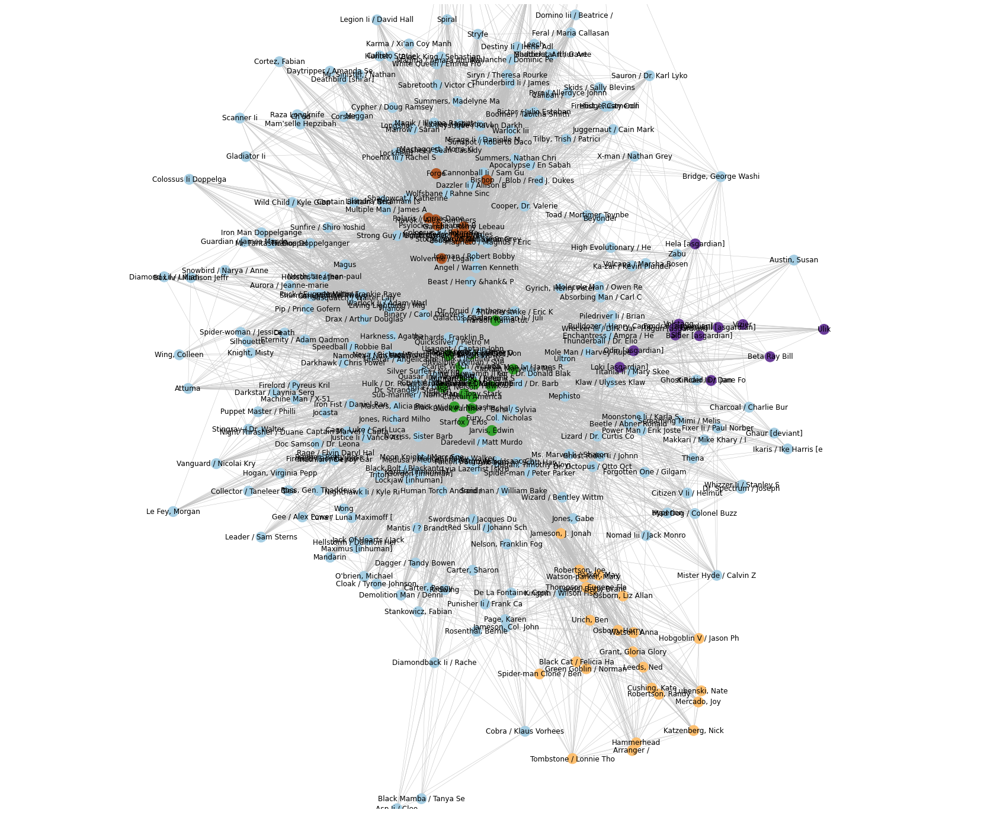

In [ ]:
#Compute DBSCAN clusters

db = DBSCAN(eps=0.9, min_samples=9)
db_clusters = list(db.fit_predict(Agg_comics))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_comics, node_color=db_clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1., .75])
plt.axis('off')

print('Number of clusters: ', max(db_clusters)-min(db_clusters)+1)
print('Number of noise noddes: ', np.sum(db_clusters==-1))

## Node2Vec

In [ ]:
#train model on the new graph

def train_model(G, P, Q):
  
  node2vec = Node2Vec(G, p = P, q = Q, dimensions=128, walk_length=80, num_walks=10, workers=8)
  model = node2vec.fit(window=10, min_count=1, batch_words=4)
  model.wv.save_word2vec_format("friends_model")
  node_embeddings = (model.wv.vectors)

  return node_embeddings

### Films + DBSCAN

In [ ]:
emb_films_1 = train_model(G_films, 0.01, 1)

In [ ]:
emb_films_2 = train_model(G_films, 0.1, 1)

In [ ]:
emb_films_3 = train_model(G_films, 1, 0.01)

Number of clusters:  5
Number of noise noddes:  0


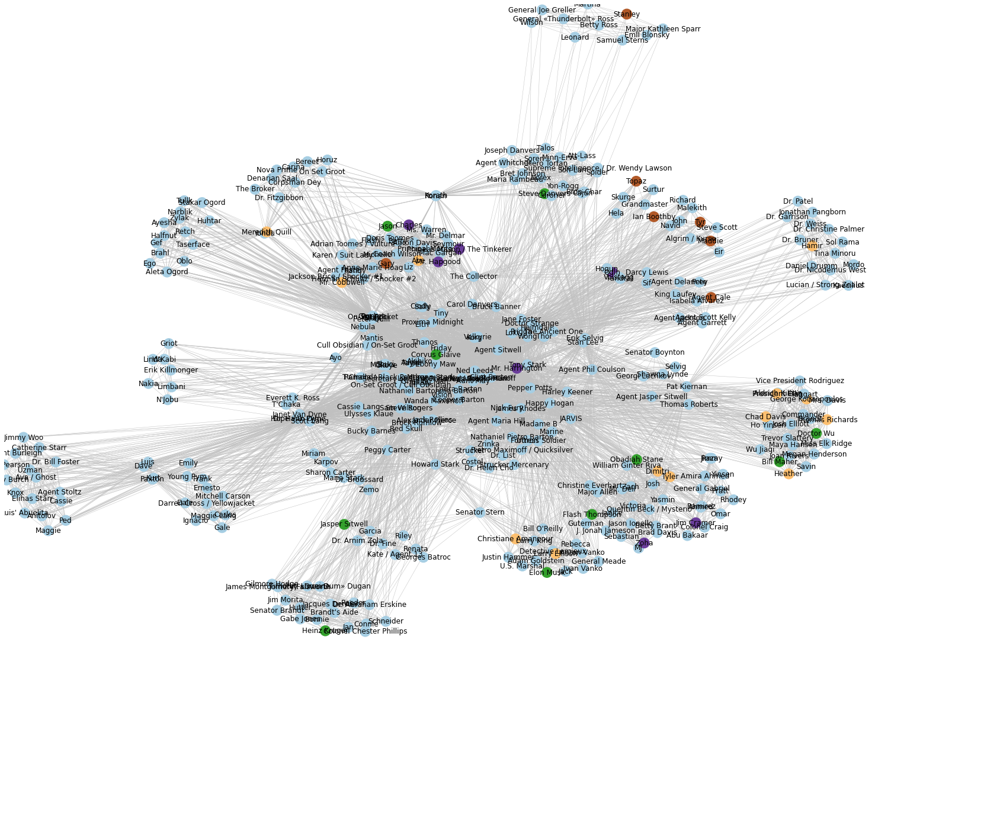

In [ ]:
db = DBSCAN(eps=4.1, min_samples=7)
db_clusters = list(db.fit_predict(emb_films_1))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_films, node_color=db_clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1.2, 1.])
plt.axis('off')

print('Number of clusters: ', max(db_clusters)-min(db_clusters)+1)
print('Number of noise noddes: ', np.sum(db_clusters==-1))

Number of clusters:  5
Number of noise noddes:  0


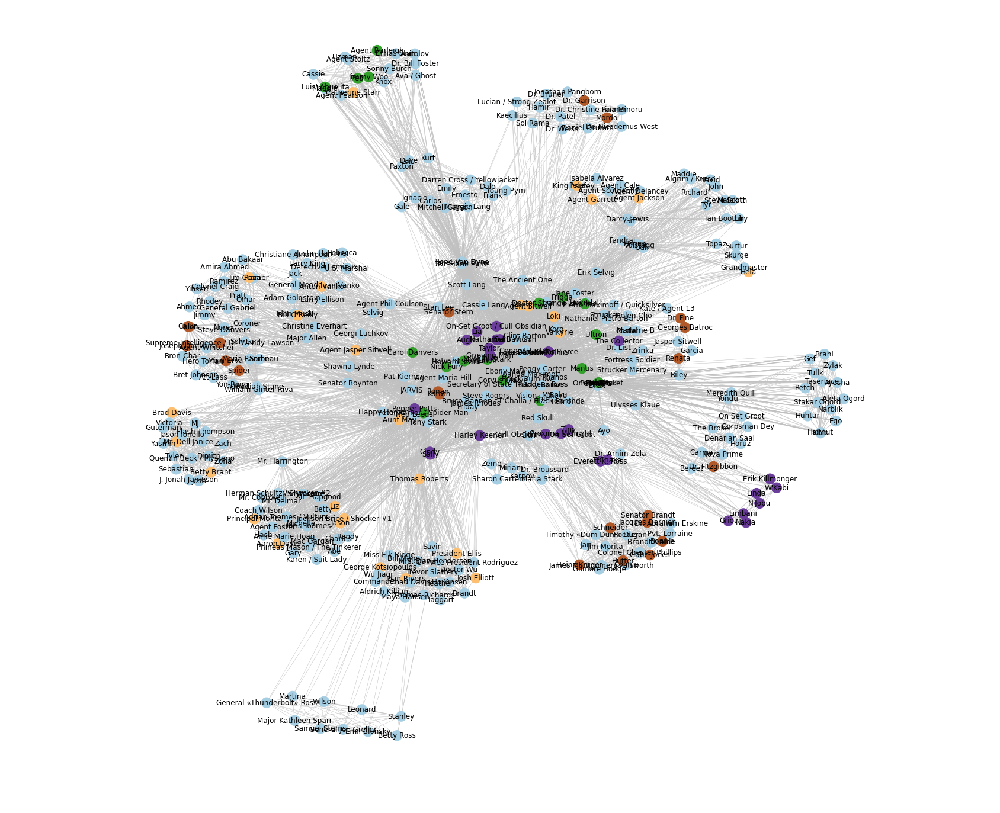

In [ ]:
db = DBSCAN(eps=4.2, min_samples=19)
db_clusters = list(db.fit_predict(emb_films_2))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_films, node_color=db_clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1.2, 1.])
plt.axis('off')

print('Number of clusters: ', max(db_clusters)-min(db_clusters)+1)
print('Number of noise noddes: ', np.sum(db_clusters==-1))

Number of clusters:  5
Number of noise noddes:  0


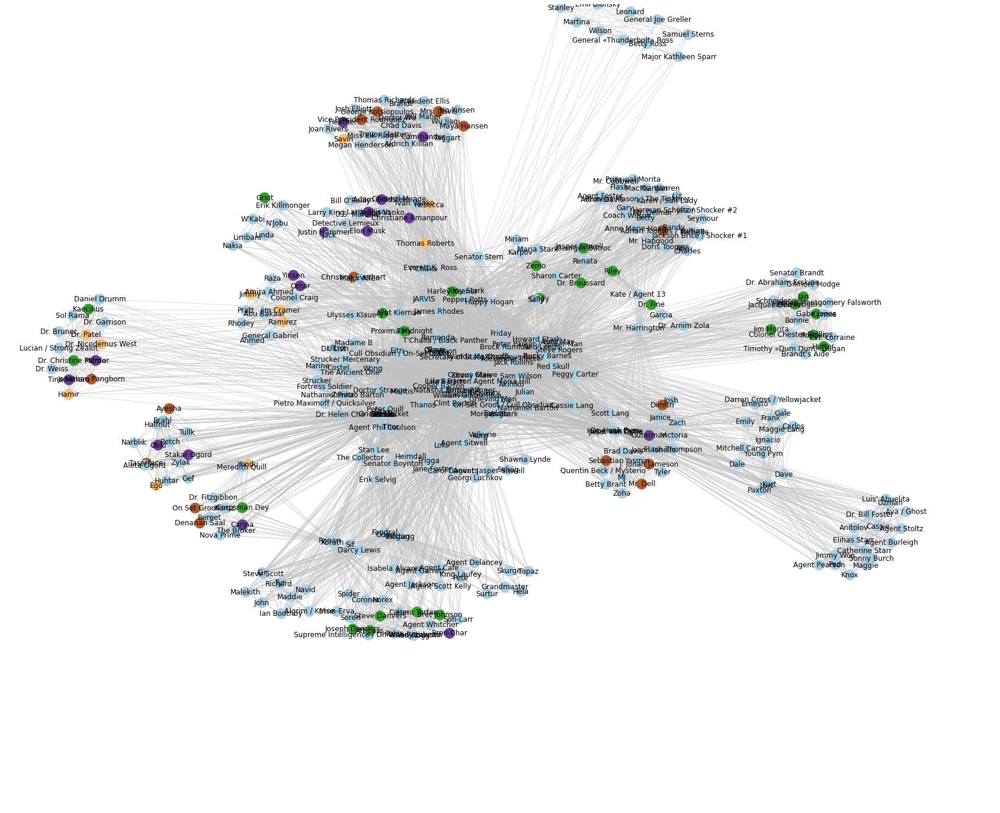

In [ ]:
db = DBSCAN(eps=1.5, min_samples=11)
db_clusters = list(db.fit_predict(emb_films_3))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_films, node_color=db_clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1.2, 1.])
plt.axis('off')

print('Number of clusters: ', max(db_clusters)-min(db_clusters)+1)
print('Number of noise noddes: ', np.sum(db_clusters==-1))

### Comics + Agglomerative clusters

In [ ]:
emb_comics_1 = train_model(G_comics, 0.01, 1)

In [ ]:
emb_comics_2 = train_model(G_comics, 0.1, 1)

In [ ]:
emb_comics_3 = train_model(G_comics, 1, 0.01)

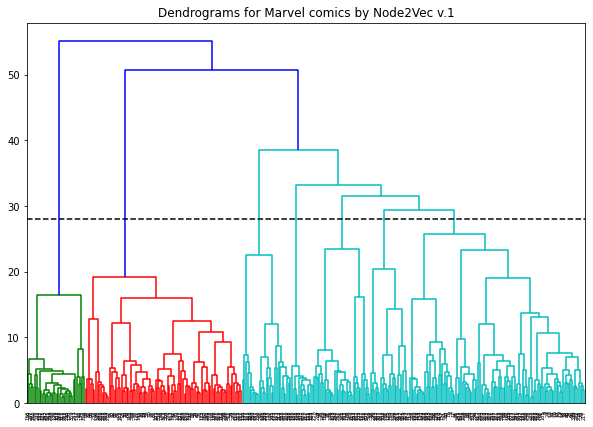

In [ ]:
plt.figure(figsize=(10, 7))  
plt.title("Dendrograms for Marvel comics by Node2Vec v.1")  
dend = shc.dendrogram(shc.linkage(emb_comics_1, method='ward'))
plt.axhline(y=28, color='black', linestyle='--')

(-0.95, 1.05, -0.9, 1.0)

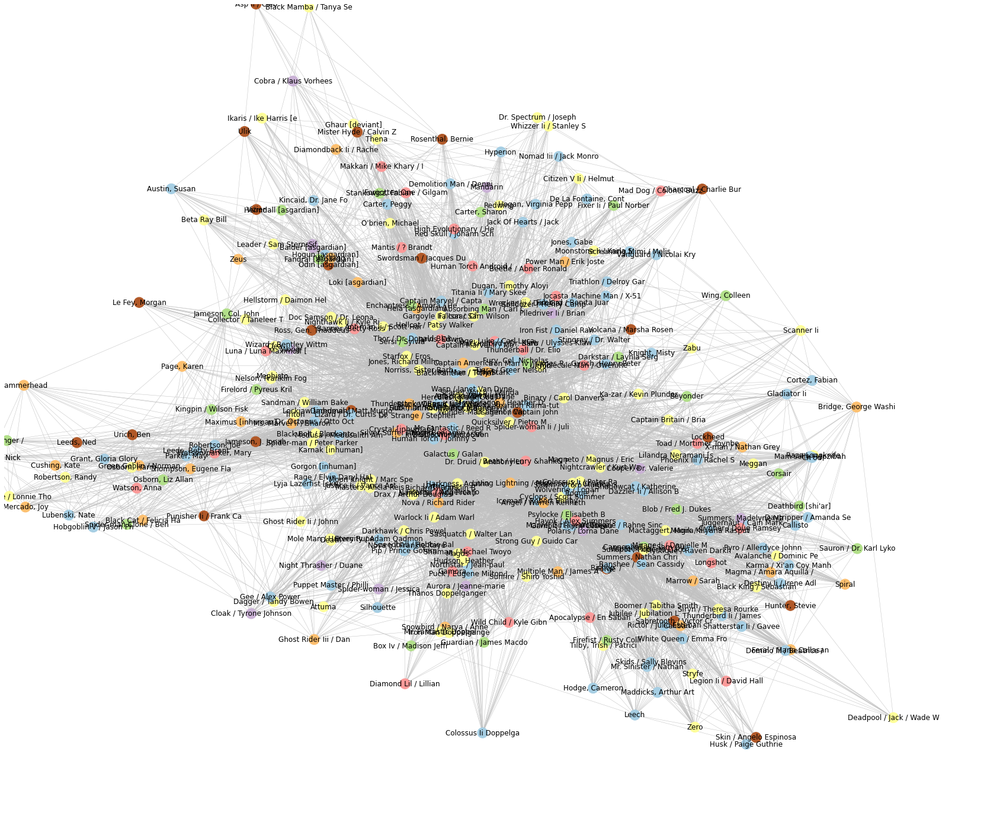

In [ ]:
cluster = AgglomerativeClustering(n_clusters=7, affinity='euclidean', linkage='ward')
clusters = list(cluster.fit_predict(emb_comics_1))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_comics, node_color=clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-.90, 1])
plt.axis('off')

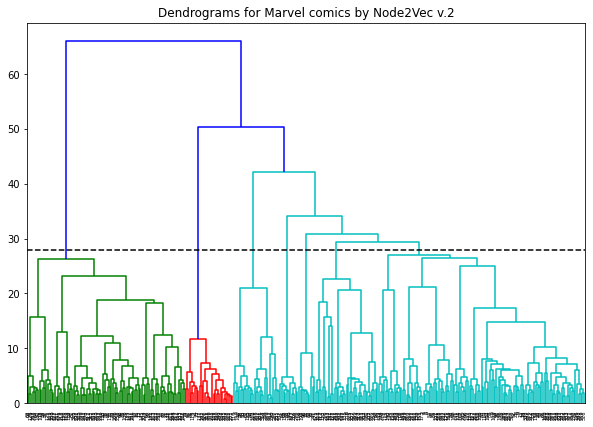

In [ ]:
plt.figure(figsize=(10, 7))  
plt.title("Dendrograms for Marvel comics by Node2Vec v.2")  
dend = shc.dendrogram(shc.linkage(emb_comics_2, method='ward'))
plt.axhline(y=28, color='black', linestyle='--')

(-0.95, 1.05, -1.1, 0.9)

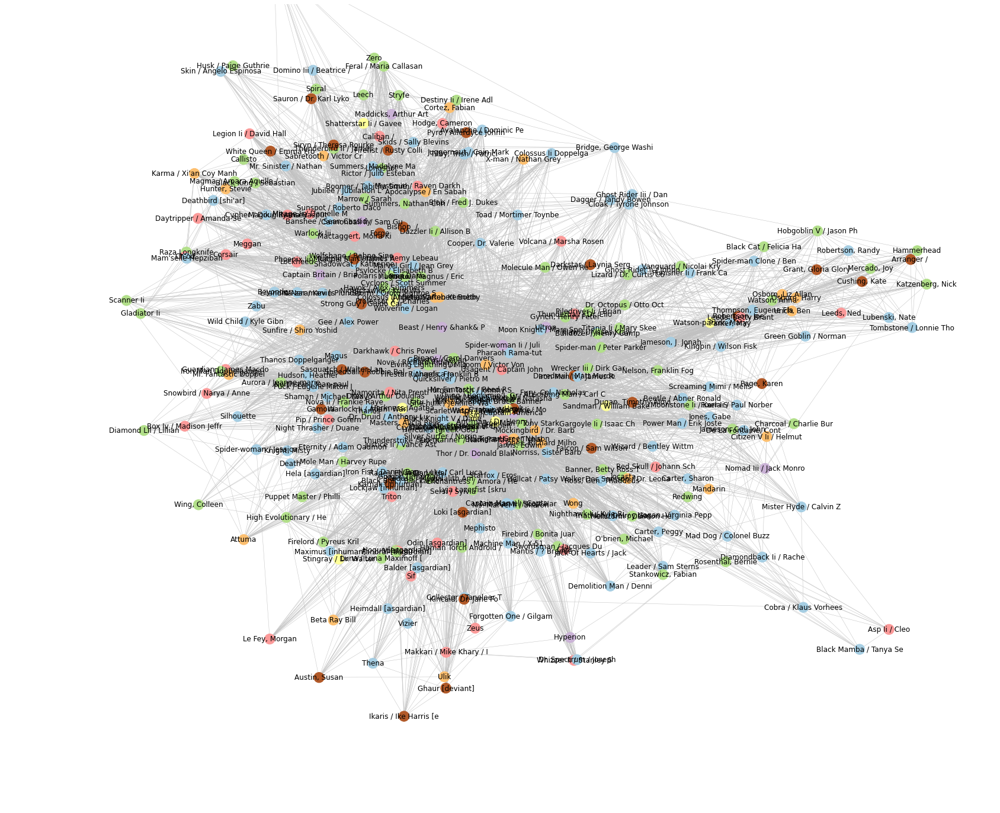

In [ ]:
cluster = AgglomerativeClustering(n_clusters=7, affinity='euclidean', linkage='ward')
clusters = list(cluster.fit_predict(emb_comics_2))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_comics, node_color=clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1.1, 0.90])
plt.axis('off')

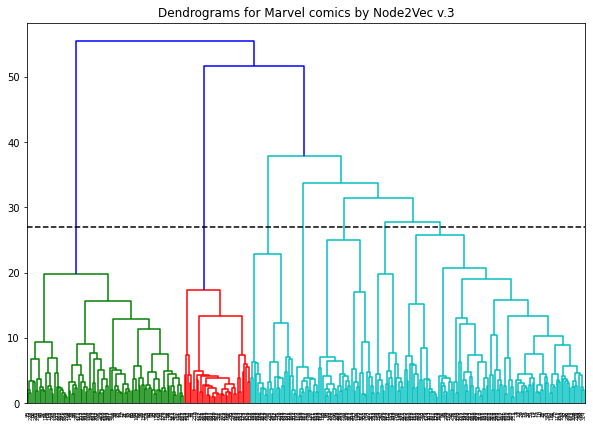

In [ ]:
plt.figure(figsize=(10, 7))  
plt.title("Dendrograms for Marvel comics by Node2Vec v.3")  
dend = shc.dendrogram(shc.linkage(emb_comics_3, method='ward'))
plt.axhline(y=27, color='black', linestyle='--')

(-0.95, 1.05, -1.1, 0.9)

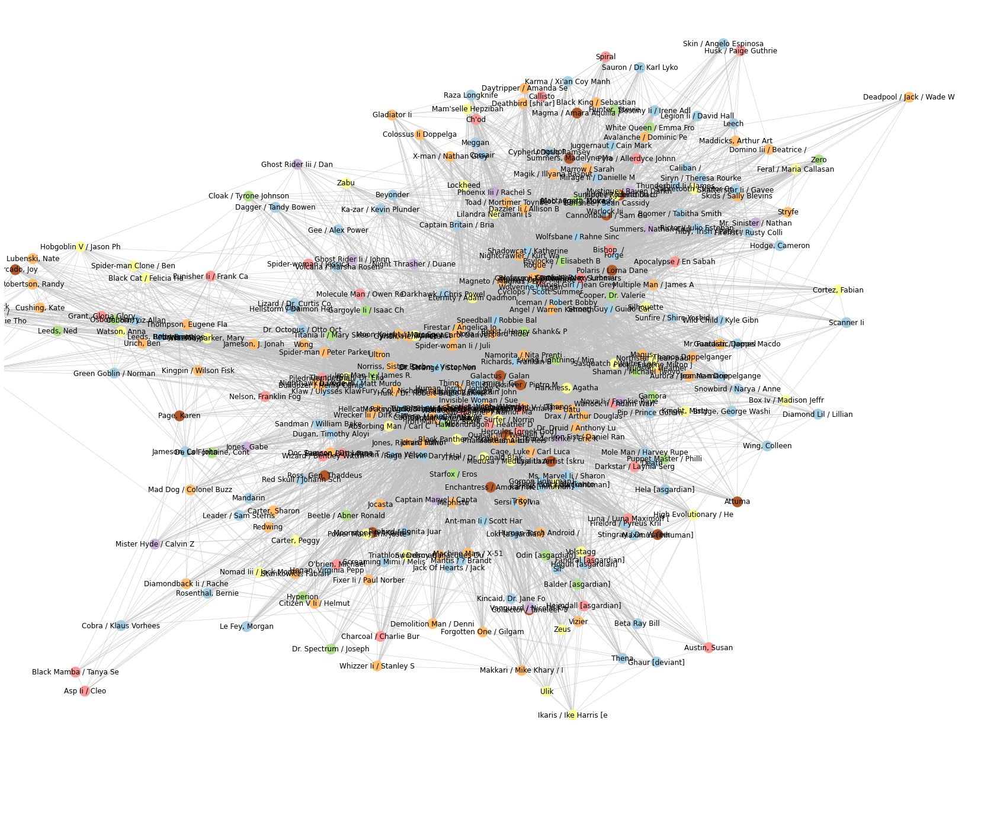

In [ ]:
cluster = AgglomerativeClustering(n_clusters=7, affinity='euclidean', linkage='ward')
clusters = list(cluster.fit_predict(emb_comics_3))

plt.figure(figsize=(30, 25))
nx.draw_networkx(G_comics, node_color=clusters, edge_color='silver', width=0.5, cmap='Paired')

plt.xlim([-.95, 1.05])
plt.ylim([-1.1, 0.90])
plt.axis('off')

# Выводы


1. Граф комиксов более плотный и связный, чем граф фильмов. Это может говорить о том, что в комиксах больше отсылок к другим героям вселенной, чем в фильмах. Большинство фильмов посвящены одному или нескольким героям. Фильмов, показывающих связь между всеми героями вселенной, единицы.
2. Структуры подграфов с сильными связями похожи на структуры полных графов. Подграф фильмов состоит по сути из двух кластеров (это видно на графике с визуализацией degree), а подграф комиксов в двух местах распадается на несвязанные с остальным графом пары. 
3. График Adjacency Matrix для фильмов показывает, что есть группа центральных персонажей, которые сильно связаны между собой, и слабо связанных узлов на периферии. На графике для комиксов похожая ситуация, но связи внутри центрального клубка не такие сильные, как у персонажей фильмов, а между периферийными узлами связей практически нет.    
4. Для графа фильмов лучше всего сработал алгоритм DBSCAN clusters с параметрами eps=2.0, min_samples=15. В нем четко выделены Мстители (зеленая группа в центре), второстепенные персонажи в фильмах про Мстителей (голубые узлы вокруг центрального зеленого кластера) и второстепенные персонажи отдельных фильмов (разноцветные группы на периферии графа). 
5. Для графа комиксов оба алгоритма сработали плохо. При большом количестве графов, узлы разных цветов перемешиваются друг с другом. Единственный график по комиксам, для которого мне удалось найти объяснение — это граф DBSCAN clusters с параметрами eps=0.9, min_samples=9, в котором получилось 5 кластеров: герои историй про Человека-паука (оранжевый), герои историй про Тора (фиолетовый), герои историй про Людей Х (коричневый), а также центральный кластер (зеленый) c героями историй про Железного человека.  